# General

The spatially-adaptive-combi framework aims at providing a generalized interface for calculating the Combination Technique with spatial adaptive strategies.

Currently this is restricted to the calculation of an integral over a function $f$:

$$\int_{x \in D} f(x) dx$$

where $x$ is an d-dimensional vector and D is the d-dimensional Domain which is defined by the lower bound $a$ and the upper bound $b$. Usually one defines $D=[0,1]^d$ but other rectangular domains are also possible.

# Functions

So let's first look at the pre-defined functions that we can use in the framework. All implemented funcitons can be found in Functions.py and they typically offer the functionality to evaluate the function at a certain point and to return the analytic integral value for a specified domain. Furthermore plotting a function is already available directly in the framework. So let's try one of the functions namely $GenzCornerPeak$.

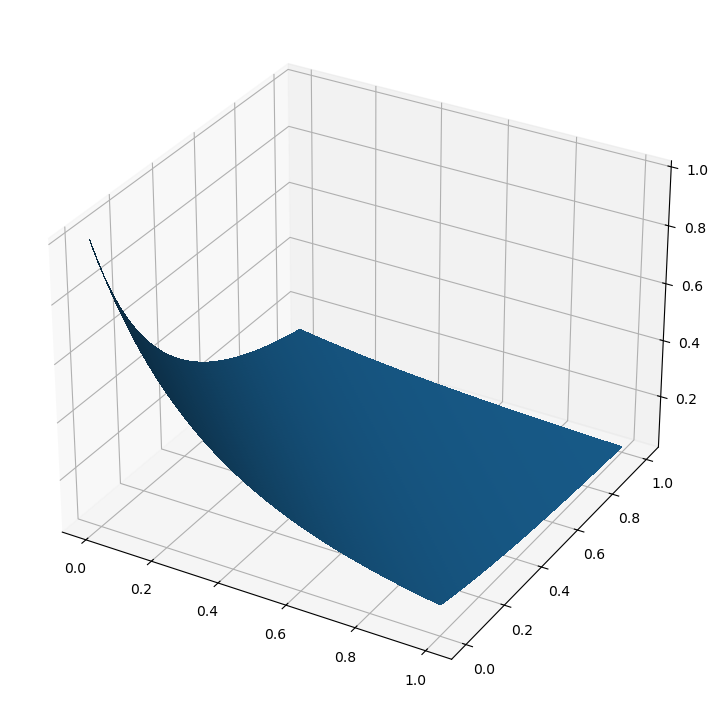

The function value at (0,0.5) is 0.2962962962962963
The analytical integral value in the Domain [0,1]^d is 0.16666666666666663


In [1]:
%matplotlib inline
import sparseSpACE


import matplotlib.pyplot as plt
# plt.rcParams["figure.figsize"] = (4,4)
# plt.rcParams["figure.dpi"] = 100

from sparseSpACE.Function import *
import numpy as np
dim = 2
coeffs = np.ones(dim)
a = np.zeros(dim)
b = np.ones(dim)
f = GenzCornerPeak(coeffs=coeffs)
f.plot(a, b)
print("The function value at (0,0.5) is", f.eval((0,0.5)))
print("The analytical integral value in the Domain [0,1]^d is", 
      f.getAnalyticSolutionIntegral(np.zeros(dim), np.ones(dim)))

There are many more functions pre-defined in Function.py. It is also possible to compose functions and create combined and scaled functions.

# Standard Combination Technique

So now let's first look at the Truncated Combination Technique with a predefined maximum und minimum level and let's integrate the GenzCornerPeak from before with it. For this purpose we also have to select a grid on which we want to perform the combi. We will use here the equidistant Trapezoidal grid that applies the trapezoidal rule to integrate the function. There are more grids available such as Leja, Clenshaw-Curtis, Gauss-Legendre...

Time used (s):0.0016124410030897707
Number of distinct points used during the refinement (StdCombi): 113
Analytic Solution: 0.16666666666666663 
Difference 3.848557324429014e-05: 
Combination Scheme:


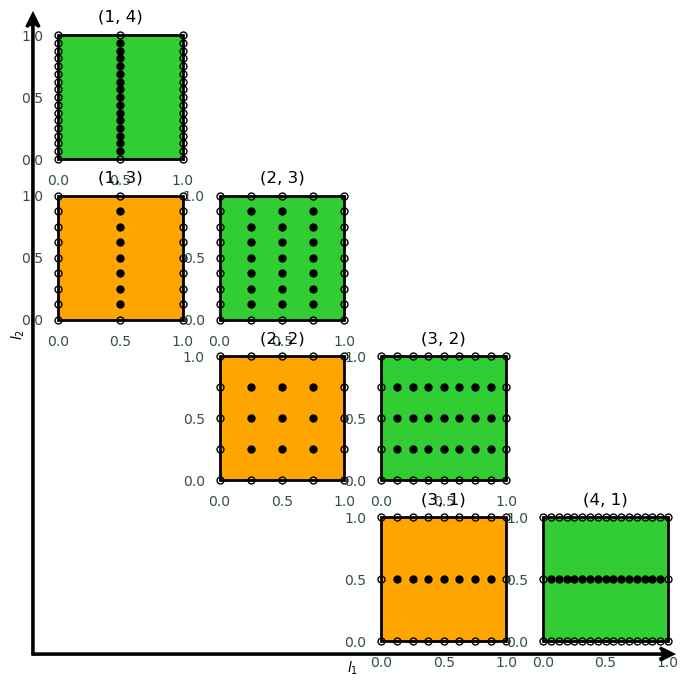

Sparse Grid:


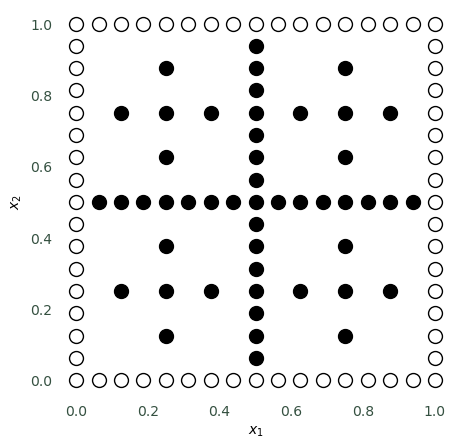

Plot of combimodel for function:


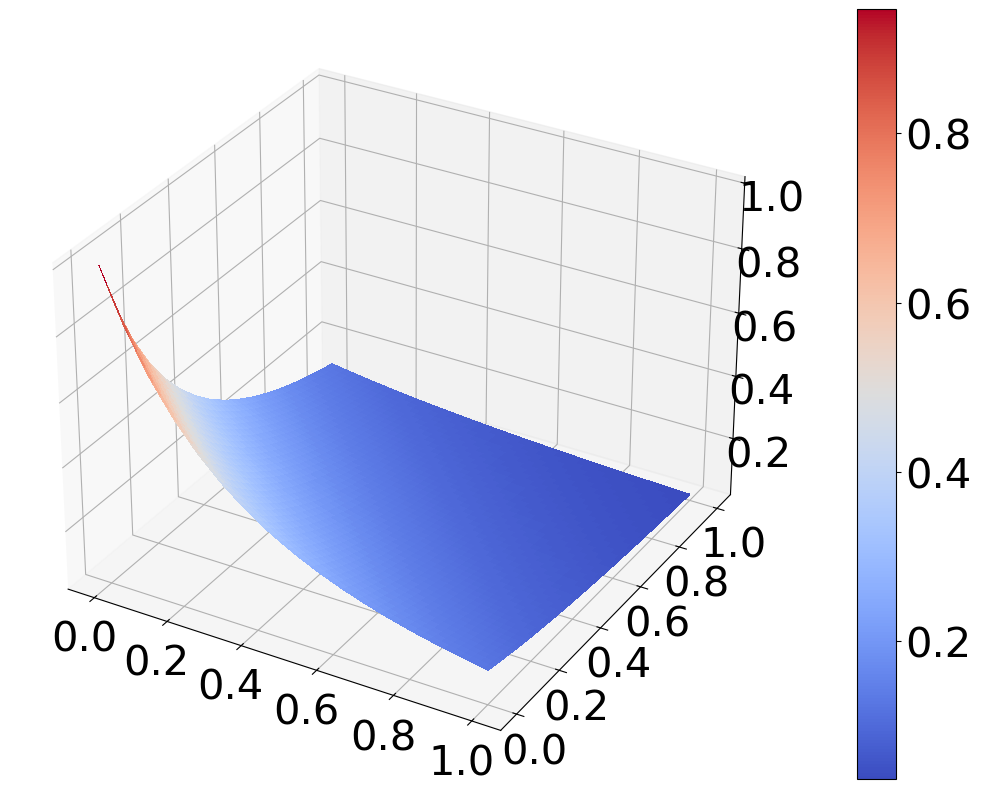

In [6]:
%matplotlib inline
import sparseSpACE
from sparseSpACE.Function import *
from sparseSpACE.StandardCombi import *
from sparseSpACE.Grid import *
import numpy as np

import matplotlib.pyplot as plt
# plt.rcParams["figure.figsize"] = (4,4)
# plt.rcParams["figure.dpi"] = 20


dim = 2
coeffs = np.ones(dim)
a = np.zeros(dim)
b = np.ones(dim)
grid = TrapezoidalGrid(a=a, b=b, boundary=True)
f = GenzCornerPeak(coeffs=coeffs)
# NEW! define operation which shall be performed in the combination technique
from sparseSpACE.GridOperation import *
operation = Integration(f=f, grid=grid, dim=dim, reference_solution = f.getAnalyticSolutionIntegral(a,b))
combiObject = StandardCombi(a, b, operation=operation)
minimum_level = 1
maximum_level = 4
combiObject.perform_operation(minimum_level, maximum_level)
print("Combination Scheme:")
combiObject.print_resulting_combi_scheme(markersize=5, figsize=2, fontsize=10)
print("Sparse Grid:")
combiObject.print_resulting_sparsegrid(markersize=10, figsize=5, fontsize=10)
print("Plot of combimodel for function:")
combiObject.plot()


The output shows the combination Scheme that is used which defines the level vectors and the coefficients of the grids. Then the solution of the combination integral is listed followed by the analytic solution and the absolute error. Finally the graphical plot of the combination scheme and the resulting sparse grid is shown.

# Dimension Adaptive Combination Technique

An often used variant of the Standard Combination Technique is the dimension adaptive Combination Technique. An implementation which applies this method is now available within the framework. It is called similarly to the Standard Combination Technique but now we also have to define a tolerance to indicate how long we want to adapt the scheme. The adaptation stops once the relative error of the integration falls below this tolerance threshold.

0 [1, 1] -1
1 [1, 2] 1
2 [2, 1] 1
[1 1]
[1 2]
0.0035775141409587863
[1 1]
[2 1]
0.0006675307467723102
Current combi integral: [0.04367776]
Current relative error: 16.47449821561668
Current error: [16.47449822]
Refining (1, 2)
0 [1, 1] -1
1 [1, 3] 1
2 [2, 1] 1
[1 2]
[1 3]
0.0009924767207381484
[1 1]
[2 1]
0.0006675307467723102
Current combi integral: [0.01688089]
Current relative error: 5.753668321240021
Current error: [5.75366832]
Refining (1, 3)
0 [1, 1] -1
1 [2, 1] 1
2 [1, 4] 1
[1 1]
[2 1]
0.0006675307467723102
[1 3]
[1 4]
0.00026078981922717176
Current combi integral: [0.00358061]
Current relative error: 0.4325229774887778
Current error: [0.43252298]
Refining (2, 1)
0 [1, 2] -1
1 [2, 1] -1
2 [2, 2] 1
3 [3, 1] 1
4 [1, 4] 1
[1 1]
[1 2]
[2 1]
[2 2]
0.00020025907961872675
[2 1]
[3 1]
9.911031814948463e-05
[1 3]
[1 4]
0.00026078981922717176
Current combi integral: [0.00591111]
Current relative error: 1.3649033472461027
Current error: [1.36490335]
Refining (1, 4)
0 [1, 2] -1
1 [2, 1] -1
2

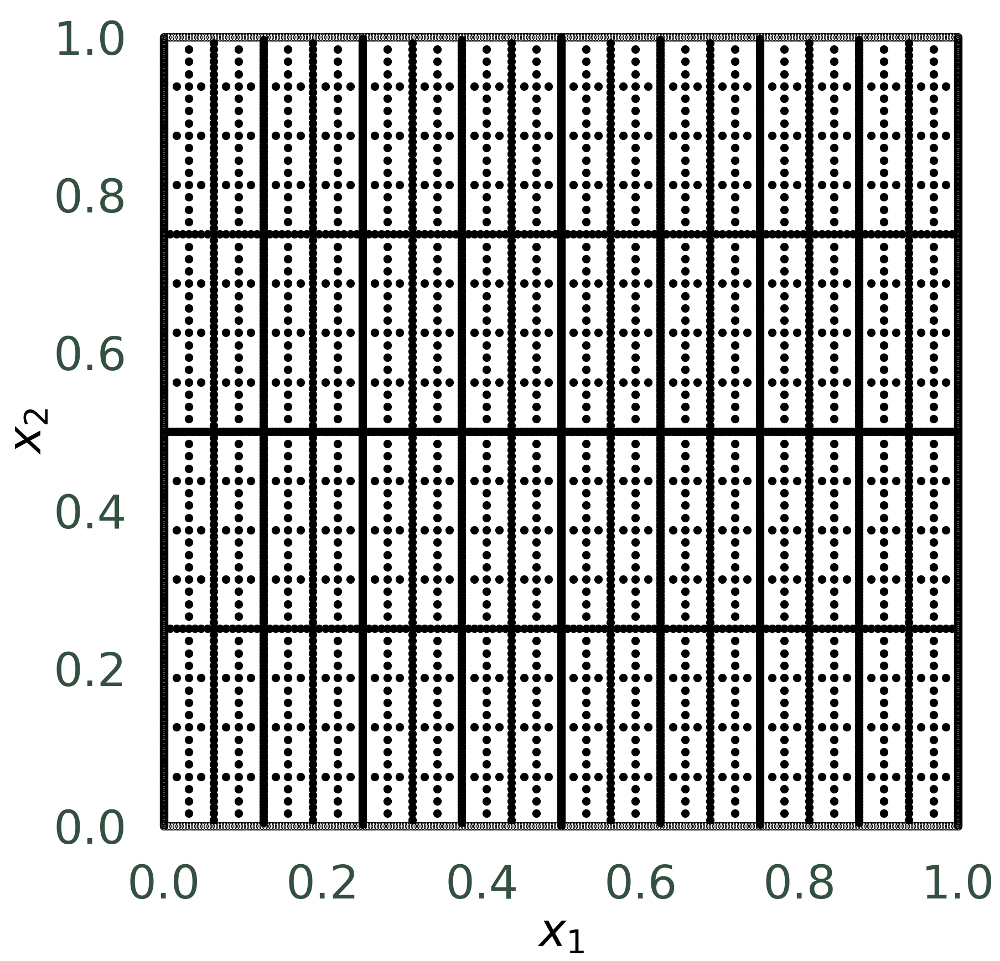

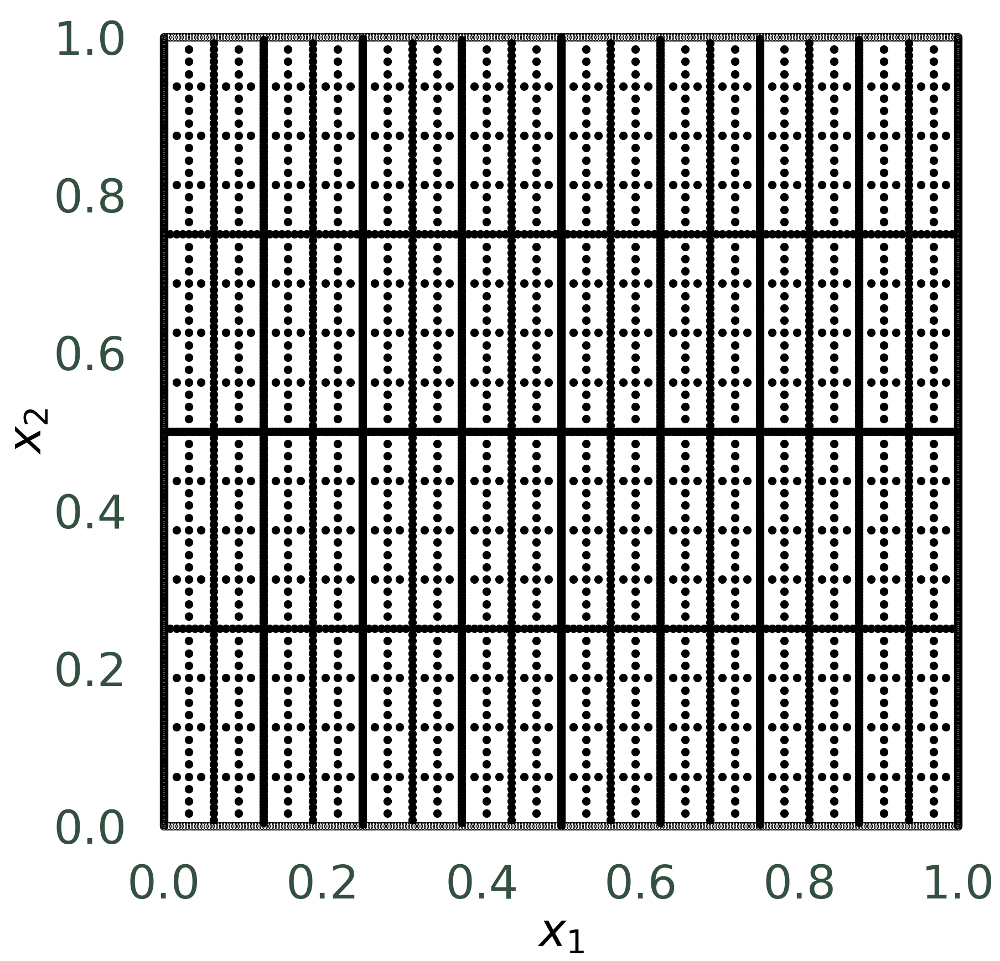

In [5]:
%matplotlib inline
import sparseSpACE
from sparseSpACE.Function import *
from sparseSpACE.DimAdaptiveCombi import *
from sparseSpACE.Grid import *
import numpy as np
dim = 2
coeffs = [1, 100]
a = np.zeros(dim)
b = np.ones(dim)
grid = TrapezoidalGrid(a=a, b=b)
f = GenzCornerPeak(coeffs=coeffs)
from sparseSpACE.GridOperation import *
operation = Integration(f=f, grid=grid, dim=dim, reference_solution = f.getAnalyticSolutionIntegral(a,b))
combiObject = DimAdaptiveCombi(a, b, operation)
minimum_level = 1
maximum_level = 2
combiObject.perform_combi(minimum_level, maximum_level, 10**-2)
# combiObject.print_resulting_combi_scheme(markersize=5)
combiObject.print_resulting_sparsegrid(markersize=10, add_refinement=False)

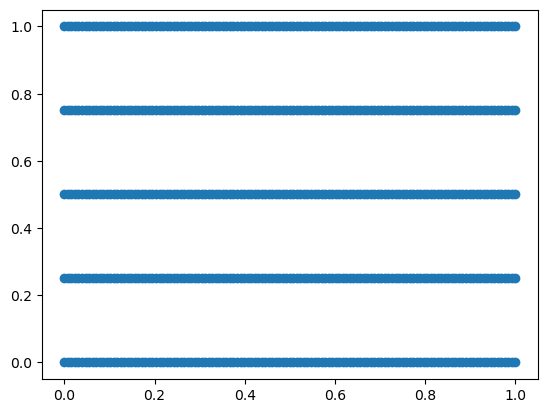

In [19]:
points = np.array(combiObject.grid.getPoints())
px = points[:,0]
py = points[:,1]

plt.scatter(px,py)

# SpatiallyAdaptiveCombi

Now we come to the core element of this framework: The spatially adaptive Combination Technique. Here several techniques are implemented and can be tested for all test functions. After configuring the grid, the function, and the dimension we need to create the object for the respective strategy (currently we have the $\textit{SpatiallyAdaptiveFixedScheme}$, the $SpatiallyAdaptiveExtendScheme$, the $SpatiallyAdaptiveCellScheme$ and the  $SpatiallyAdaptiveSingleDimensions$). The different Schemes have different configuration parameters one can choose. For further information have a look in the respective class file. The calling conventions for the spatially adaptive combi slightly differe from those of the standard combis and also include and $errorOperator$ which controls the error estimations and we also have the oportunity to plot the sparse grid and the combination scheme after each refinement step by setting $do\_plot$ to $true$. In the following we will demonstrate the refinement for to schemes including the respective plots.

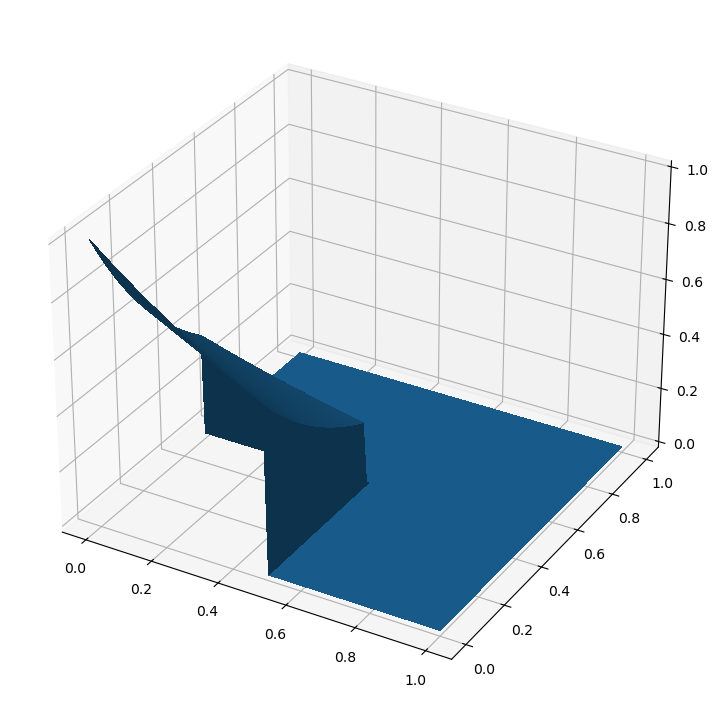

0 [2, 2] 1.0
split dimension 0
split dimension 0
split dimension 1
split dimension 1
Current number of function evaluations 25
combiintegral: 0.08843951713331462
Current error: 0.08843951713331462
Last plot
Contour plot:
Refinement Graph:


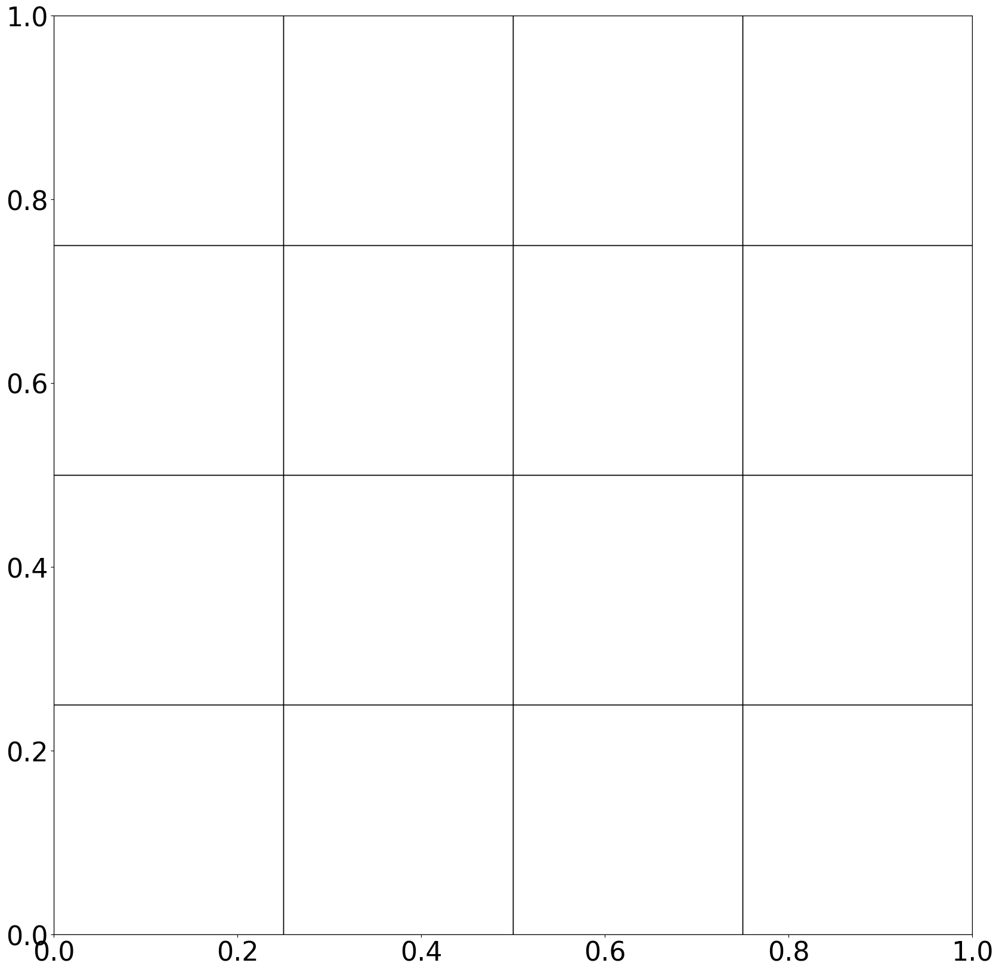

Combi Scheme:


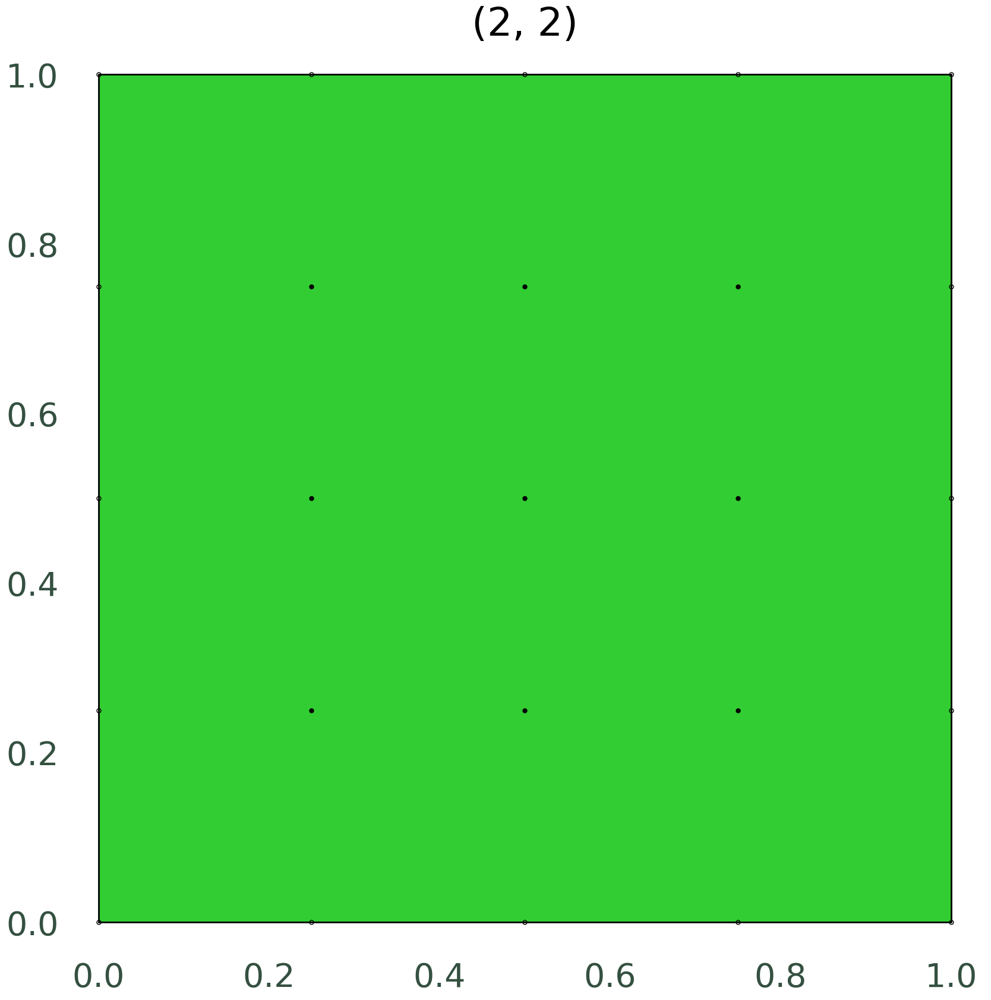

Resulting Sparse Grid:
dim 2
debug mesh None


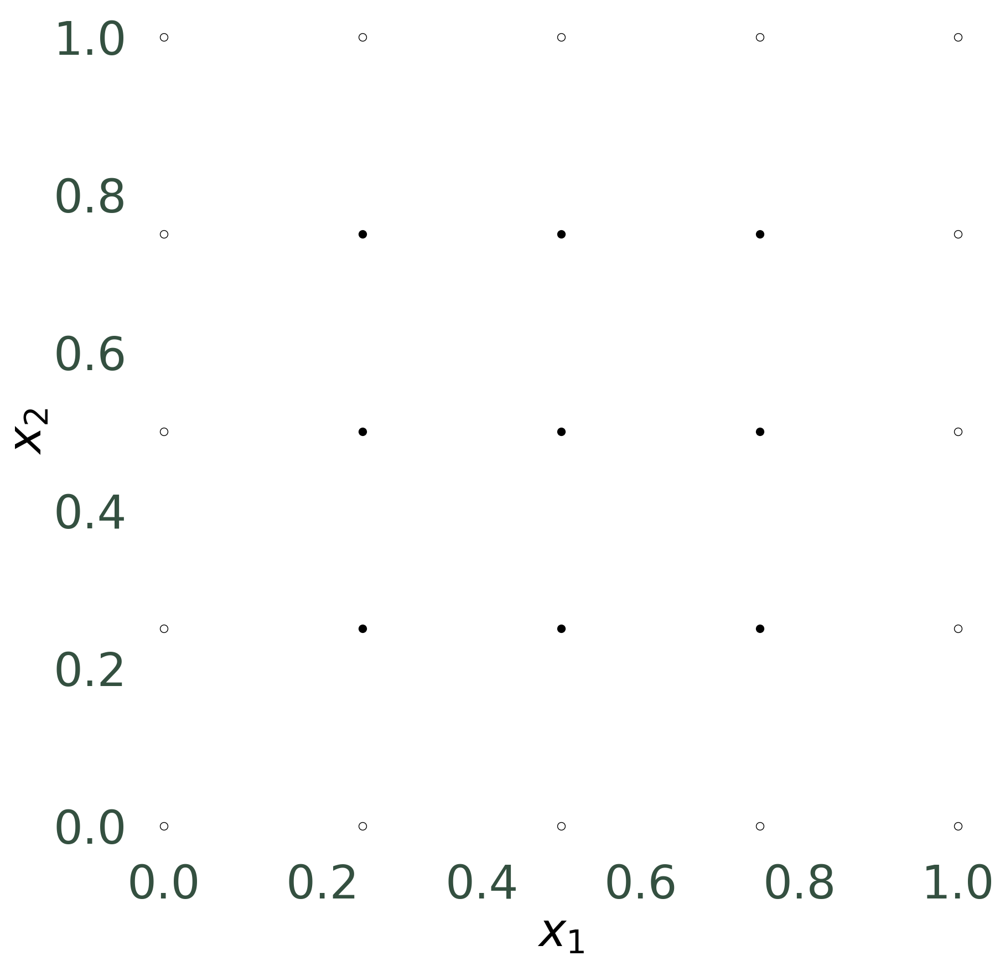

Number of refinements: 0
Number of distinct points used during the refinement: 25
Time used adaptive (s): 0.34303542799898423
Final error: 0.08843951713331462
Number of points used in refinement: 25


In [7]:
%matplotlib inline
import sparseSpACE
import numpy as np
from sparseSpACE.spatiallyAdaptiveCell import *
from sparseSpACE.Function import *
from sparseSpACE.ErrorCalculator import *

#dimension of the problem
dim = 2

# define integration domain boundaries
a = np.zeros(dim)
b = np.ones(dim)

# define function to be integrated
midpoint = np.ones(dim) * 0.5
coefficients = np.array([ 10**0 * (d+1) for d in range(dim)])
f = GenzDiscontinious(border=midpoint,coeffs=coefficients)
# plot function
f.plot(np.ones(dim)*a,np.ones(dim)*b)

# reference integral solution for calculating errors
#reference_solution = f.getAnalyticSolutionIntegral(a,b)

# define error estimator for refinement
errorOperator=ErrorCalculatorSurplusCell()

# define equidistant grid
grid=TrapezoidalGrid(a=a, b=b)

# NEW! define operation which shall be performed in the combination technique
from sparseSpACE.GridOperation import *
operation = Integration(f=f, grid=grid, dim=dim)#, reference_solution = reference_solution)

# define Cell refinement strategy for Spatially Adaptive Combination Technique
adaptiveCombiInstanceCell = SpatiallyAdaptiveCellScheme(a, b, operation=operation)

# the cell method does not have component grids and therefore the sparse grid is printed twice per iteration!
# performing the spatially adaptive refinement with the Cell method
# adaptiveCombiInstanceCell.performSpatiallyAdaptiv(2, 2, errorOperator, 10**-2, do_plot=False, do_last_plot=True)
adaptiveCombiInstanceCell.performSpatiallyAdaptiv(2, 2, errorOperator, max_evaluations=2, do_plot=False, do_last_plot=True)

print("Number of points used in refinement:", adaptiveCombiInstanceCell.get_total_num_points())



# 1 D

In [28]:
# function
from sparseSpACE.Function import Function
import numpy as np
class mysine(Function):
    def __init__(self, a, b):
        super().__init__()
        self.a = a
        self.b = b

    def eval(self,X):
        if any(np.array(X) >= self.b) or any(np.array(X) <= self.a):
            return 0
        else:
            return np.sin(X)
        


0 [2] 1.0
split dimension 0
split dimension 0
Current number of function evaluations 5
combiintegral: 0.9759677134264293
Current error: 2.356194490192345
Finished refinement
Refined 2 times
Current number of function evaluations 7
combiintegral: 1.6478673700263693
Current error: 3.028094146792285
Number of refinements: 2
Number of distinct points used during the refinement: 7
Time used adaptive (s): 0.004884531001152936
Final error: 3.028094146792285
Number of points used in refinement: 7


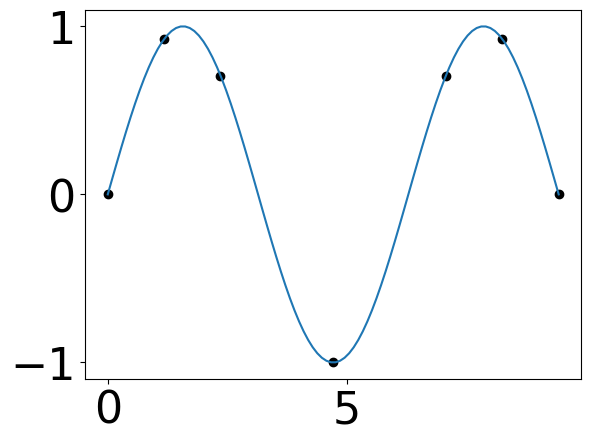

In [30]:
%matplotlib inline
import sparseSpACE
import numpy as np
from sparseSpACE.spatiallyAdaptiveCell import *
from sparseSpACE.Function import *
from sparseSpACE.ErrorCalculator import *

#dimension of the problem
dim = 1

# define integration domain boundaries
a = [0]
b = [3*np.pi]

# define function to be integrated
f = mysine(a=a[0],b=b[0])#GenzDiscontinious(border=midpoint,coeffs=coefficients)
# plot function
# f.plot(np.ones(dim)*a,np.ones(dim)*b)

# reference integral solution for calculating errors
#reference_solution = f.getAnalyticSolutionIntegral(a,b)

# define error estimator for refinement
errorOperator=ErrorCalculatorSurplusCell()

# define equidistant grid
grid=TrapezoidalGrid(a=a, b=b)

# NEW! define operation which shall be performed in the combination technique
from sparseSpACE.GridOperation import *
operation = Integration(f=f, grid=grid, dim=dim)#, reference_solution = reference_solution)

# define Cell refinement strategy for Spatially Adaptive Combination Technique
adaptiveCombiInstanceCell = SpatiallyAdaptiveCellScheme(a, b, operation=operation)

# the cell method does not have component grids and therefore the sparse grid is printed twice per iteration!
# performing the spatially adaptive refinement with the Cell method
# adaptiveCombiInstanceCell.performSpatiallyAdaptiv(2, 2, errorOperator, 10**-2, do_plot=False, do_last_plot=True)
adaptiveCombiInstanceCell.performSpatiallyAdaptiv(2, 2, errorOperator, max_evaluations=5, do_plot=False, do_last_plot=False)

print("Number of points used in refinement:", adaptiveCombiInstanceCell.get_total_num_points())

points = adaptiveCombiInstanceCell.get_points()
px = points 

plt.scatter(px, np.sin(px), c='black', label='grid points')
test = np.linspace(a[0], b[0], 100)
plt.plot(test, np.sin(test))


131 131


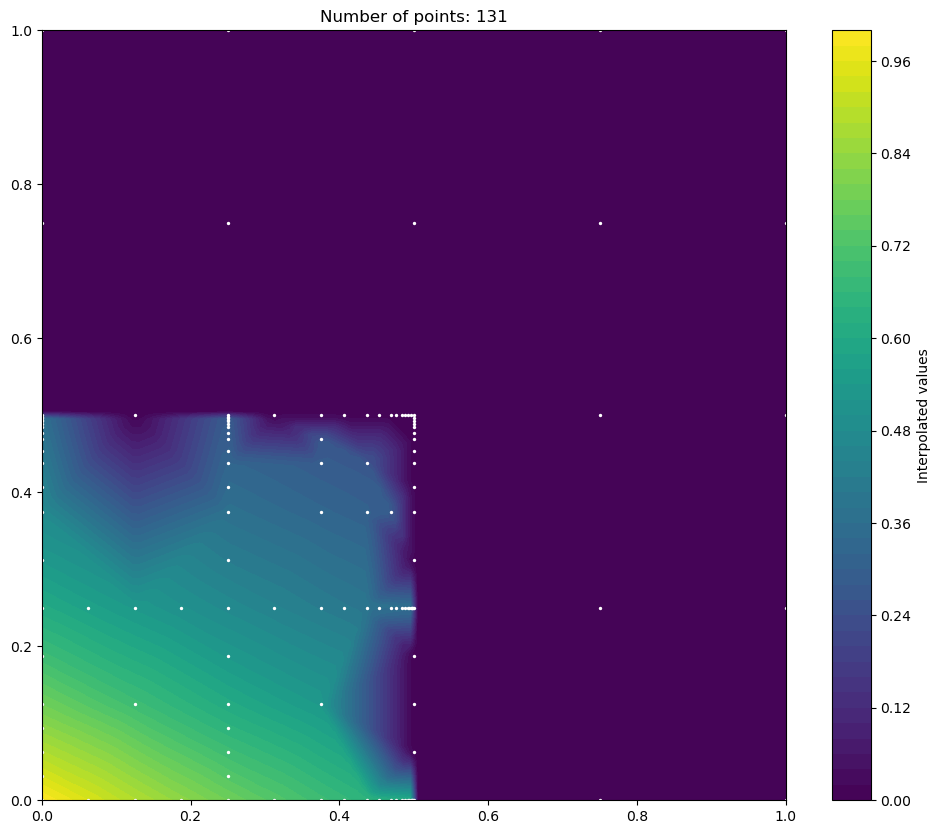

In [ ]:
from scipy.interpolate import griddata

points = adaptiveCombiInstanceCell.get_points()
p_a = np.array(points)


px, py = zip(*points) 
print(len(px), len(py))
pf = [f.eval(p) for p in points]

x = np.linspace(0,1,100)
y = np.linspace(0,1,100)
X,Y = np.meshgrid(x,y)
Z = griddata((px, py), pf, (X, Y), method='linear')

size=2
fig = plt.figure(figsize=(6*size,5*size))
plt.title(f'Number of points: {len(px)}')
plt.contourf(X,Y,Z, levels=50, cmap='viridis')
plt.colorbar(label='Interpolated values')
plt.scatter(px,py,s=2, c='white')


In [ ]:
import numpy as np
from scipy.interpolate import KroghInterpolator
import matplotlib.pyplot as plt

# Define the grid of points
x = np.array([0, 1, 2, 3])
y = np.array([0, 1, 2, 3])
X, Y = np.meshgrid(x, y)
Z = np.sin(X) * np.cos(Y)

# Flatten the grid for the interpolator
x_flat = X.flatten()
y_flat = Y.flatten()
z_flat = Z.flatten()

# Create the interpolator
interpolator = KroghInterpolator((x_flat, y_flat), z_flat)

# Define the points where we want to interpolate
x_new = np.linspace(0, 3, 100)
y_new = np.linspace(0, 3, 100)
X_new, Y_new = np.meshgrid(x_new, y_new)

# Interpolate the values
Z_new = interpolator(X_new.ravel(), Y_new.ravel()).reshape(X_new.shape)

# Plot the results
plt.figure(figsize=(8, 6))
plt.contourf(X_new, Y_new, Z_new, levels=50, cmap='viridis')
plt.colorbar(label='Interpolated values')
plt.scatter(x_flat, y_flat, color='red', label='Data points')
plt.legend()
plt.title('2D Krogh Interpolation')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()

ValueError: x and y arrays must be equal in length along interpolation axis.

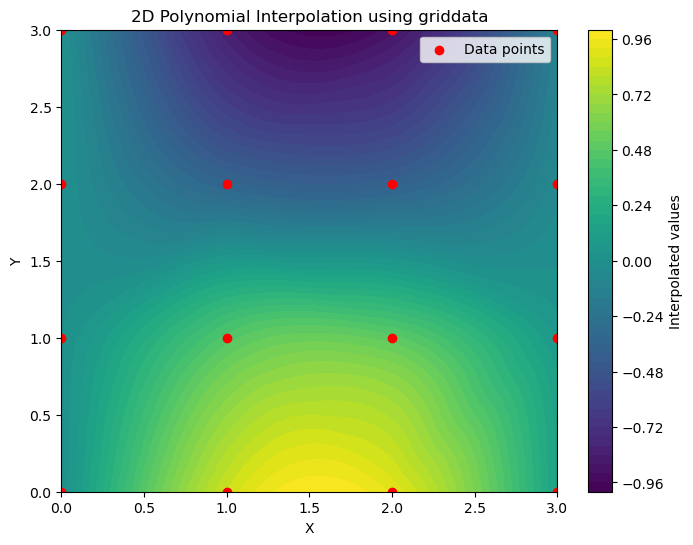

In [ ]:
import numpy as np
from scipy.interpolate import griddata
import matplotlib.pyplot as plt

# Define the grid of points
x = np.array([0, 1, 2, 3])
y = np.array([0, 1, 2, 3])
X, Y = np.meshgrid(x, y)
Z = np.sin(X) * np.cos(Y)

# Flatten the grid for the interpolator
x_flat = X.flatten()
y_flat = Y.flatten()
z_flat = Z.flatten()

# Define the points where we want to interpolate
x_new = np.linspace(0, 3, 100)
y_new = np.linspace(0, 3, 100)
X_new, Y_new = np.meshgrid(x_new, y_new)

# Interpolate the values using griddata with cubic interpolation
Z_new = griddata((x_flat, y_flat), z_flat, (X_new, Y_new), method='cubic')

# Plot the results
plt.figure(figsize=(8, 6))
plt.contourf(X_new, Y_new, Z_new, levels=50, cmap='viridis')
plt.colorbar(label='Interpolated values')
plt.scatter(x_flat, y_flat, color='red', label='Data points')
plt.legend()
plt.title('2D Polynomial Interpolation using griddata')
plt.xlabel('X')
plt.ylabel('Y')
plt.show()


In [14]:
f.eval((0.1,0.1))

0.7408182206817179

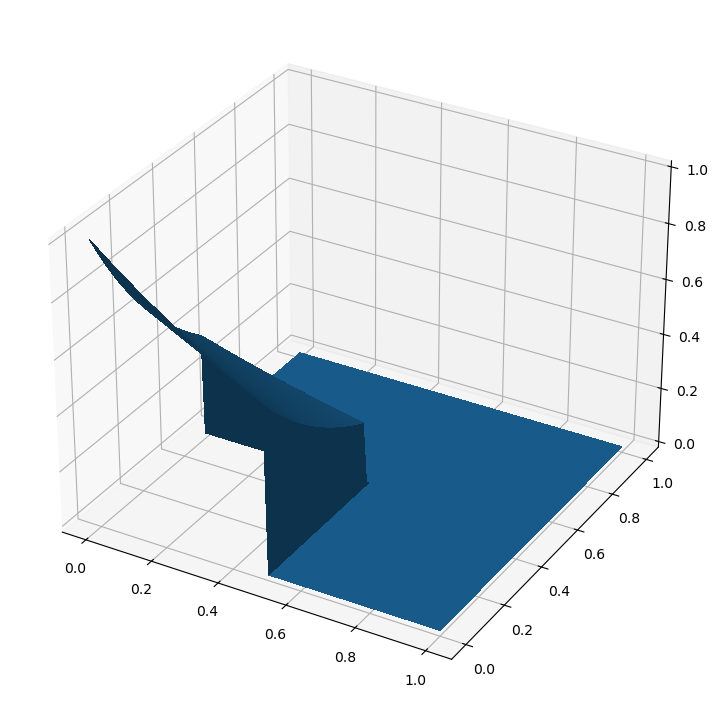

0 [1, 2] 1.0
1 [2, 1] 1.0
2 [1, 1] -1.0
Current number of function evaluations 21
combiintegral: 0.08658321517400241
Current error: 0.3037697447476341
Finished refinement
Refined 1 times
Current number of function evaluations 34
combiintegral: 0.10428157211486151
Current error: 0.161454267715295
Finished refinement
Refined 1 times
Current number of function evaluations 47
combiintegral: 0.10837460765796411
Current error: 0.12854147768775417
Finished refinement
Refined 2 times
Current number of function evaluations 69
combiintegral: 0.11427649713677684
Current error: 0.08108338768673931
Finished refinement
Refined 2 times
Current number of function evaluations 93
combiintegral: 0.11611314122153847
Current error: 0.06631462243158524
Finished refinement
Refined 2 times
Current number of function evaluations 119
combiintegral: 0.11765333407978167
Current error: 0.05392967155308622
Finished refinement
Refined 1 times
Current number of function evaluations 130
combiintegral: 0.11832051433377

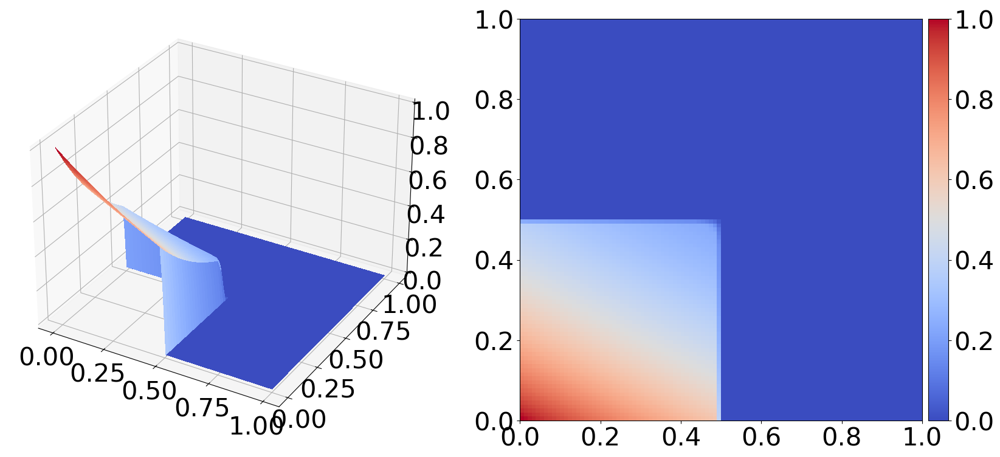

Refinement Graph:


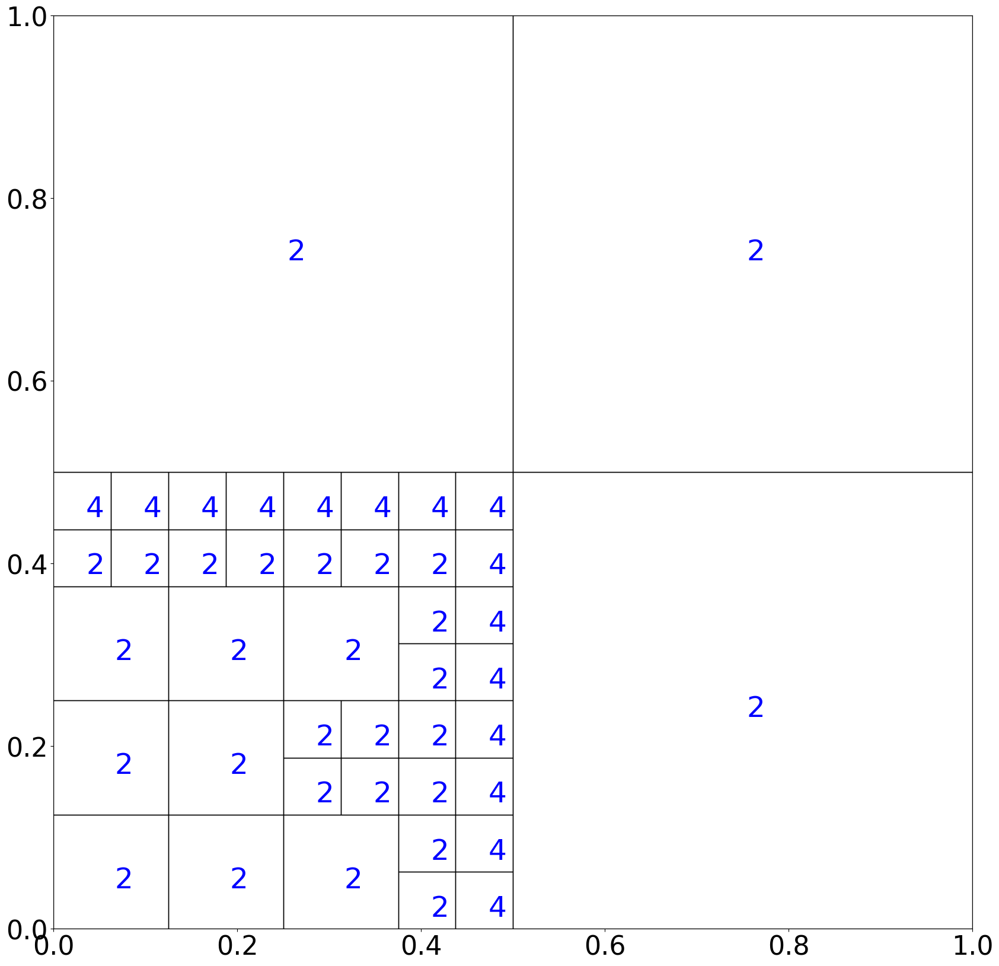

Combi Scheme:


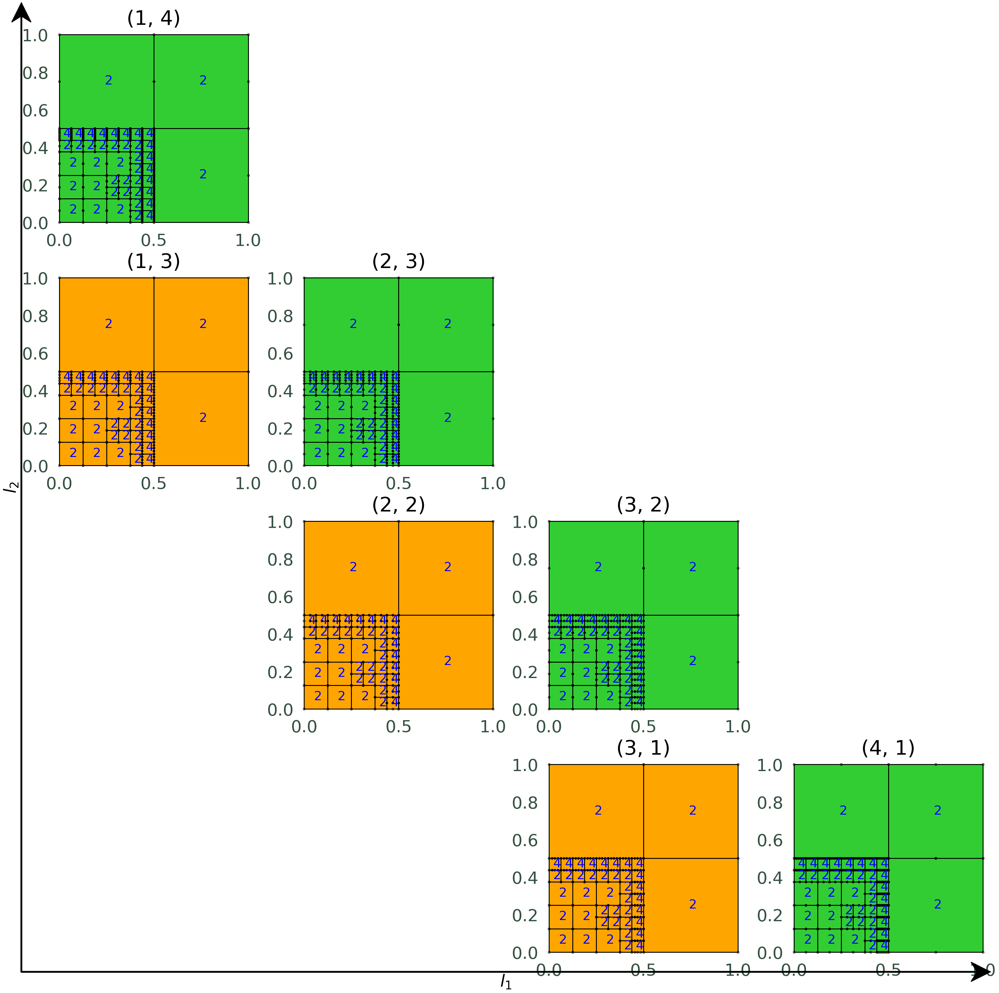

Resulting Sparse Grid:
dim 2
debug mesh [array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.01010101, 0.01010101, 0.01010101, ..., 0.01010101, 0.01010101,
        0.01010101],
       [0.02020202, 0.02020202, 0.02020202, ..., 0.02020202, 0.02020202,
        0.02020202],
       ...,
       [0.97979798, 0.97979798, 0.97979798, ..., 0.97979798, 0.97979798,
        0.97979798],
       [0.98989899, 0.98989899, 0.98989899, ..., 0.98989899, 0.98989899,
        0.98989899],
       [1.        , 1.        , 1.        , ..., 1.        , 1.        ,
        1.        ]]), array([[0.        , 0.01010101, 0.02020202, ..., 0.97979798, 0.98989899,
        1.        ],
       [0.        , 0.01010101, 0.02020202, ..., 0.97979798, 0.98989899,
        1.        ],
       [0.        , 0.01010101, 0.02020202, ..., 0.97979798, 0.98989899,
        1.        ],
       ...,
       [0.        , 0.01010101, 0.02020202, ..., 0.97979798, 0.98989899,
        1.    

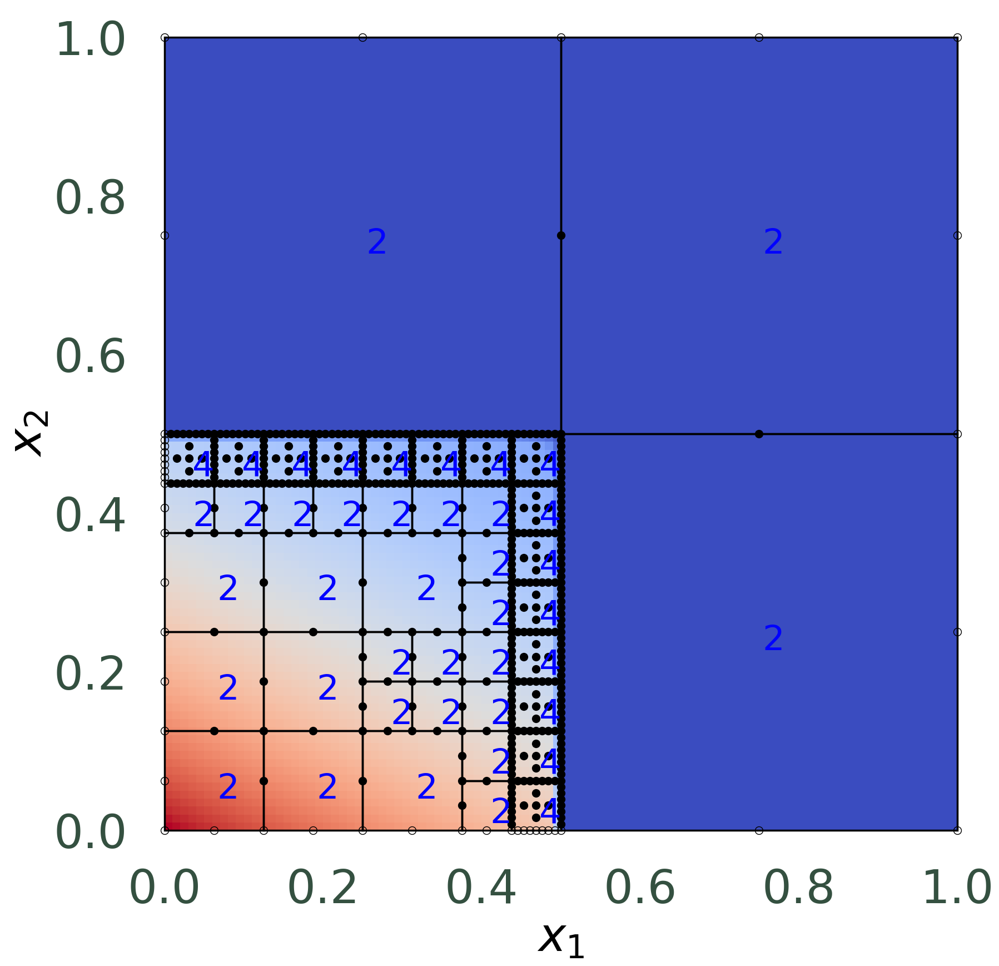

Number of refinements: 43
Number of distinct points used during the refinement: 519
Time used adaptive (s): 4.583811367001545
Final error: 0.009918588222579692
Number of points used in refinement: 519


In [ ]:
%matplotlib inline
import sparseSpACE
import numpy as np
from sparseSpACE.spatiallyAdaptiveExtendSplit import *
from sparseSpACE.Function import *
from sparseSpACE.ErrorCalculator import *

# dimension of the problem
dim = 2

# define integration domain boundaries
a = np.zeros(dim)
b = np.ones(dim)

# define function to be integrated
midpoint = np.ones(dim) * 0.5
coefficients = np.array([ 10**0 * (d+1) for d in range(dim)])
f = GenzDiscontinious(border=midpoint,coeffs=coefficients)
# plot function
f.plot(np.ones(dim)*a,np.ones(dim)*b)

# reference integral solution for calculating errors
reference_solution = f.getAnalyticSolutionIntegral(a,b)

# define error estimator for refinement
errorOperator2=ErrorCalculatorExtendSplit()

# define equidistant grid
grid=TrapezoidalGrid(a=a, b=b)

# NEW! define operation which shall be performed in the combination technique
from sparseSpACE.GridOperation import *
operation = Integration(f=f, grid=grid, dim=dim, reference_solution = reference_solution)

# define Extend-Split refinement strategy for Spatially Adaptive Combination Technique
adaptiveCombiInstanceExtend = SpatiallyAdaptiveExtendScheme(a, b, 3, version=0, operation=operation)

# performing the spatially adaptive refinement with the Extend-Split method
adaptiveCombiInstanceExtend.performSpatiallyAdaptiv(1, 2, errorOperator2, 10**-2, do_plot=False, do_last_plot=True)

print("Number of points used in refinement:", adaptiveCombiInstanceExtend.get_total_num_points())

0 [1, 2] 1.0
1 [2, 1] 1.0
2 [1, 1] -1.0
Current number of function evaluations 21
combiintegral: 0.08658321517400241
Current error: 0.3037697447476341
Finished refinement
Refined 1 times
Current number of function evaluations 34
combiintegral: 0.10428157211486151
Current error: 0.161454267715295
Finished refinement
Refined 1 times
Current number of function evaluations 47
combiintegral: 0.10837460765796411
Current error: 0.12854147768775417
Finished refinement
Refined 2 times
Current number of function evaluations 69
combiintegral: 0.11427649713677684
Current error: 0.08108338768673931
Finished refinement
Refined 2 times
Current number of function evaluations 93
combiintegral: 0.11611314122153847
Current error: 0.06631462243158524
Finished refinement
Refined 2 times
Current number of function evaluations 119
combiintegral: 0.11765333407978167
Current error: 0.05392967155308622
Number of refinements: 8
Number of distinct points used during the refinement: 119
Time used adaptive (s): 0.0

Text(0, 0.5, 'RMSE')

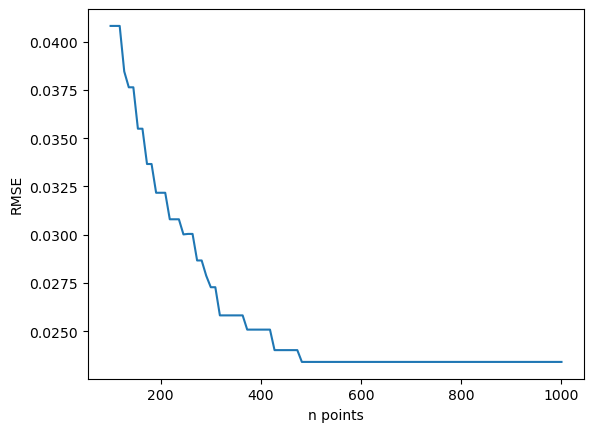

In [56]:
max_points = np.linspace(100,1000,100)

all_rmse = []
for max in max_points:
    adaptiveCombiInstanceExtend.performSpatiallyAdaptiv(1, 2, errorOperator2, 10**-2, do_plot=False, do_last_plot=False, max_evaluations=max)
    points = adaptiveCombiInstanceExtend.get_points()
    pf = [f.eval(p) for p in points]

    px, py = zip(*points) 
    x = np.linspace(0,1,100)
    y = np.linspace(0,1,100)
    X,Y = np.meshgrid(x,y)
    Z_interp = griddata((px, py), pf, (X, Y), method='linear')
    points_test = list(zip(X.flatten(),Y.flatten()))
    print(points_test)
    Z_true = np.array([f.eval(p) for p in points_test])

    rmse = np.sqrt(np.mean((Z_true-Z_interp.flatten())**2))
    all_rmse.append(rmse)

plt.plot(max_points, all_rmse)
plt.xlabel('n points')
plt.ylabel('RMSE')




2433 2433


Text(0.5, 1.0, 'Number of points:2433')

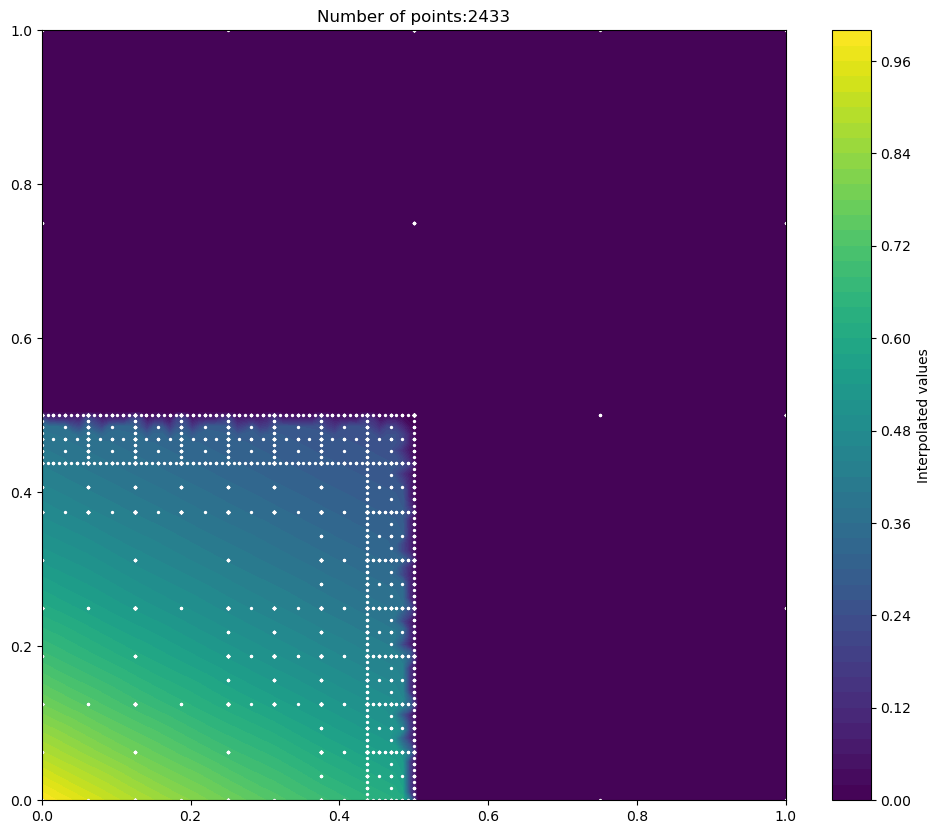

In [ ]:
from scipy.interpolate import griddata

points = adaptiveCombiInstanceExtend.get_points()


px, py = zip(*points) 
print(len(px), len(py))

x = np.linspace(0,1,100)
y = np.linspace(0,1,100)
X,Y = np.meshgrid(x,y)
Z = griddata((px, py), pf, (X, Y), method='linear')

size=2
fig = plt.figure(figsize=(6*size,5*size))

plt.contourf(X,Y,Z, levels=50, cmap='viridis')
plt.colorbar(label='Interpolated values')
plt.scatter(px,py,s=2, c='white')
plt.title(f'Number of points:{len(px)}')


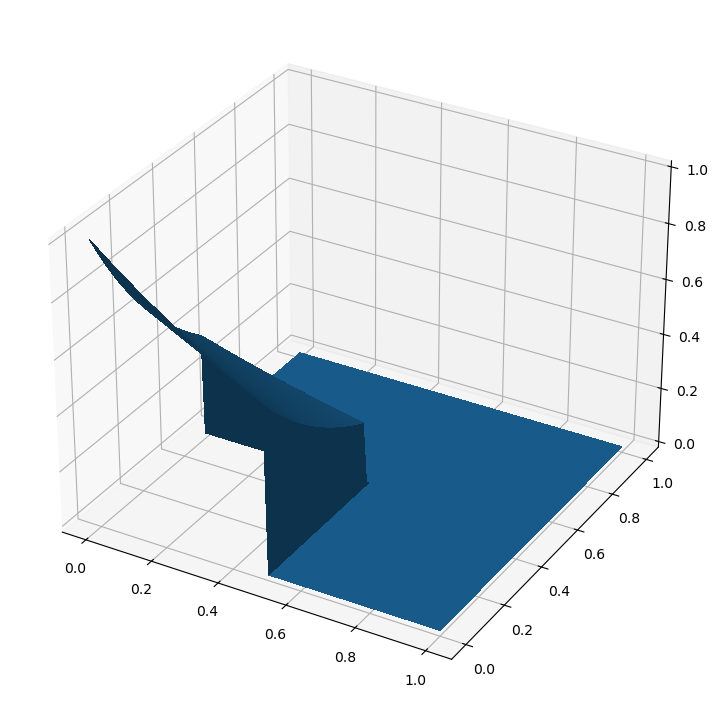

0 [1, 2] 1.0
1 [2, 1] 1.0
2 [1, 1] -1.0
Current number of function evaluations 21
combiintegral: 0.08658321517400241
Current error: 0.3037697447476341
Finished refinement
Refined 2 times
Current number of function evaluations 27
combiintegral: 0.09567650887100748
Current error: 0.2306490344687724
Finished refinement
Refined 2 times
Current number of function evaluations 33
combiintegral: 0.10037298519988029
Current error: 0.19288387517471547
Finished refinement
Refined 2 times
Current number of function evaluations 41
combiintegral: 0.10774088015232228
Current error: 0.133637387583532
Finished refinement
Refined 2 times
Current number of function evaluations 48
combiintegral: 0.1119718594072807
Current error: 0.09961536887323974
Finished refinement
Refined 2 times
Current number of function evaluations 56
combiintegral: 0.1156764078048176
Current error: 0.06982646959029541
Finished refinement
Refined 2 times
Current number of function evaluations 67
combiintegral: 0.11948108943836268
C

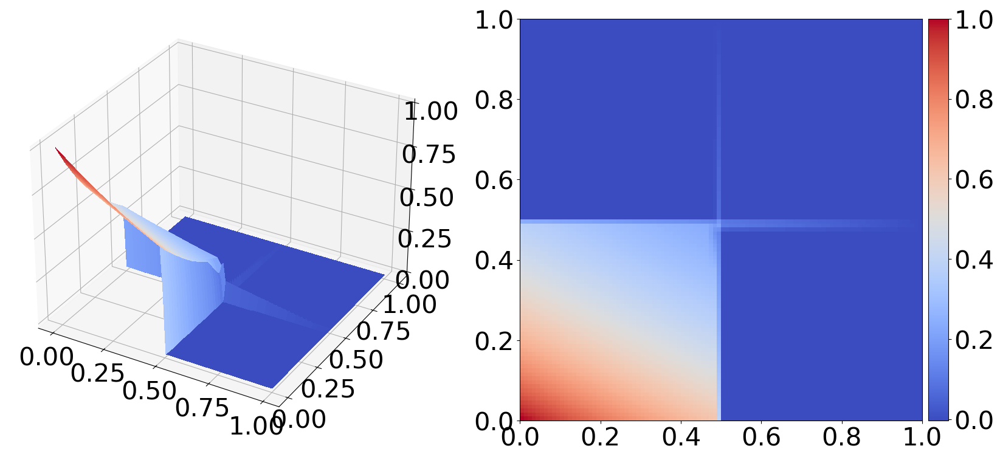

Refinement Graph:


/home/djdaniel/anaconda3/envs/gene_ml/lib/python3.12/site-packages/sparseSpACE/spatiallyAdaptiveSingleDimension2.py:574: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  axis.plot(xValues[1:-1], yValues[1:-1], 'bo', markersize=markersize, color="black")
/home/djdaniel/anaconda3/envs/gene_ml/lib/python3.12/site-packages/sparseSpACE/spatiallyAdaptiveSingleDimension2.py:575: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "bo" (-> color='b'). The keyword argument will take precedence.
  axis.plot([xValues[0], xValues[-1]], [yValues[0], yValues[-1]], 'bo', markersize=markersize, color="black", fillstyle='none')


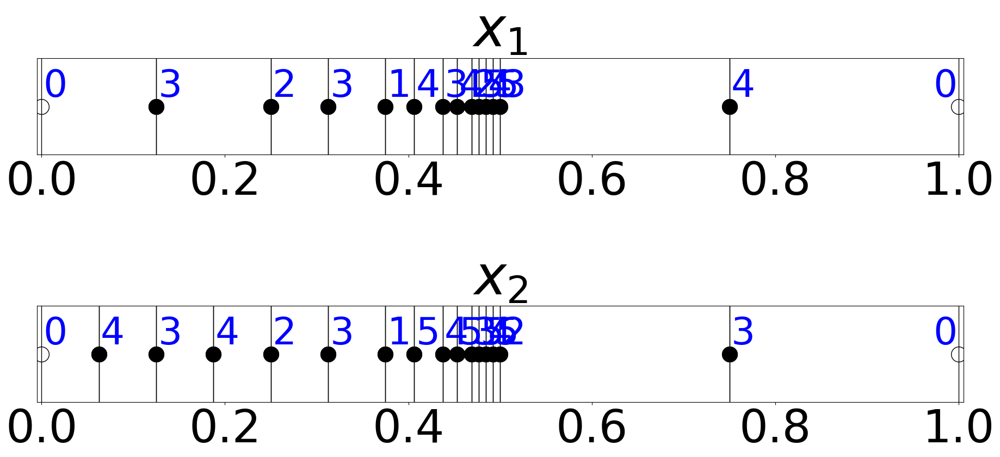

Combi Scheme:


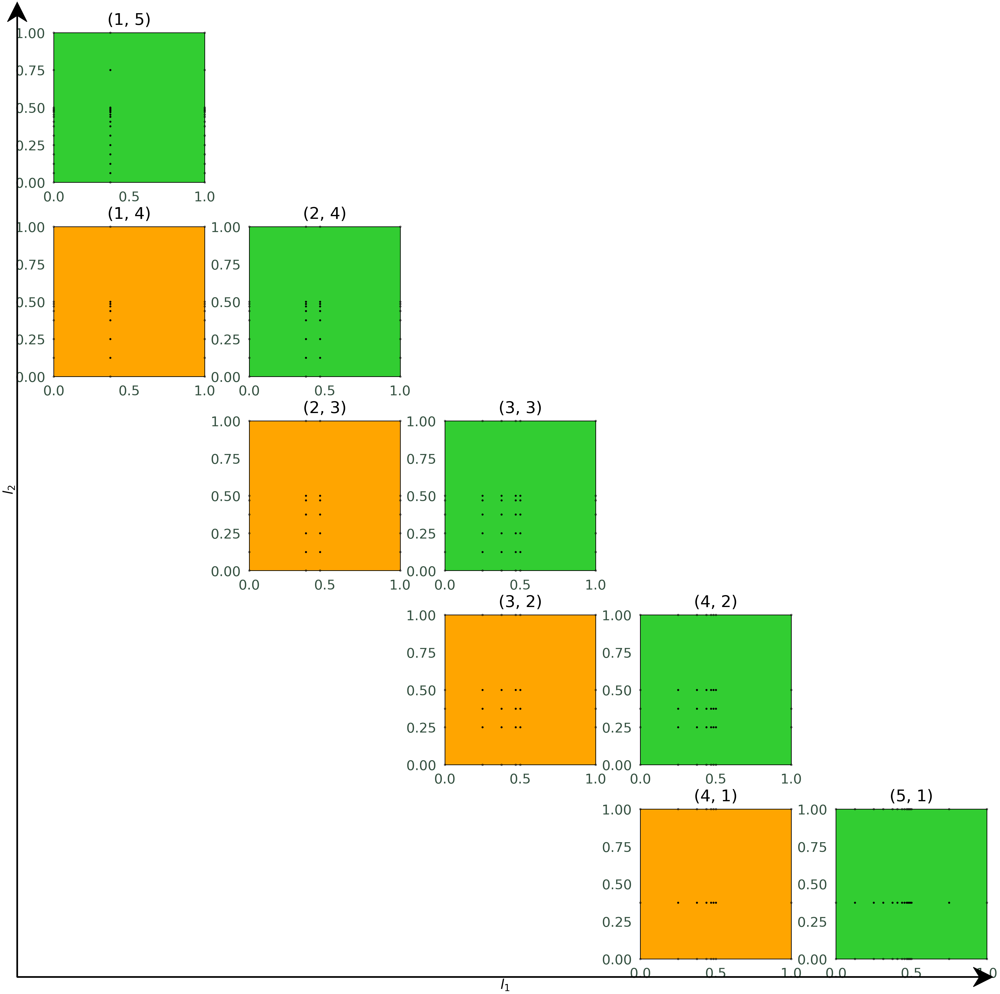

Resulting Sparse Grid:
dim 2


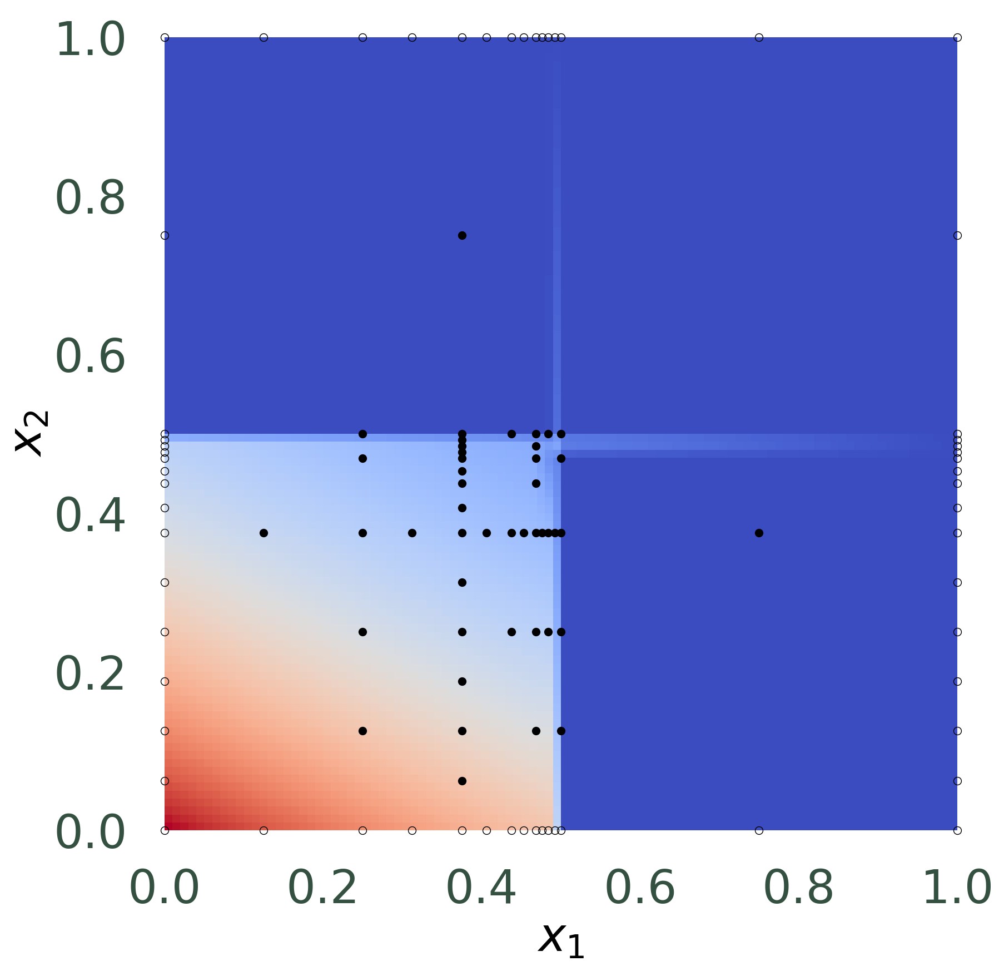

Number of refinements: 22
Number of distinct points used during the refinement: 114
Time used adaptive (s): 4.222030765999989
Final error: 0.0040272145143659946
Number of points used in refinement: 114


In [2]:
%matplotlib inline
import sparseSpACE
import numpy as np
from sparseSpACE.spatiallyAdaptiveSingleDimension2 import *
from sparseSpACE.Function import *
from sparseSpACE.ErrorCalculator import *

# dimension of the problem
dim = 2

# define integration domain boundaries
a = np.zeros(dim)
b = np.ones(dim)

# define function to be integrated
midpoint = np.ones(dim) * 0.5
coefficients = np.array([ 10**0 * (d+1) for d in range(dim)])
f = GenzDiscontinious(border=midpoint,coeffs=coefficients)
# plot function
f.plot(np.ones(dim)*a,np.ones(dim)*b)

# reference integral solution for calculating errors
reference_solution = f.getAnalyticSolutionIntegral(a,b)

# define error estimator for refinement
errorOperator = ErrorCalculatorSingleDimVolumeGuided()

# define equidistant grid
grid=GlobalTrapezoidalGrid(a=a, b=b, modified_basis=False, boundary=True)

# NEW! define operation which shall be performed in the combination technique
from sparseSpACE.GridOperation import *
operation = Integration(f=f, grid=grid, dim=dim, reference_solution=reference_solution)

# define SingleDim refinement strategy for Spatially Adaptive Combination Technique
adaptiveCombiInstanceSingleDim = SpatiallyAdaptiveSingleDimensions2(np.ones(dim) * a, np.ones(dim) * b, operation=operation)

# performing the spatially adaptive refinement with the SingleDim method
adaptiveCombiInstanceSingleDim.performSpatiallyAdaptiv(1, 2, errorOperator, 10**-2, do_plot=False, do_last_plot=True)

print("Number of points used in refinement:", adaptiveCombiInstanceSingleDim.get_total_num_points())

Now experiment with different functions, different dimensions and different tolerances to get to know the framework.